In [1]:
import numpy as np
import pandas as pd
import cv2
import imageio
import os
import time

import matplotlib.pyplot as plt
%matplotlib inline

# Downsample France Planet imagery

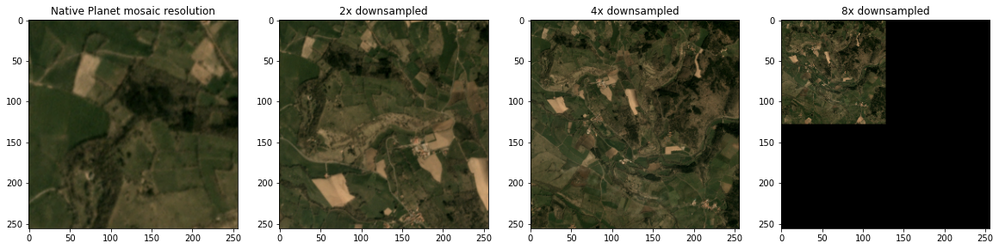

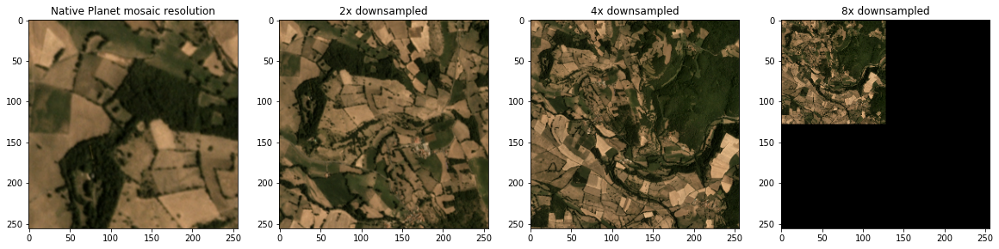

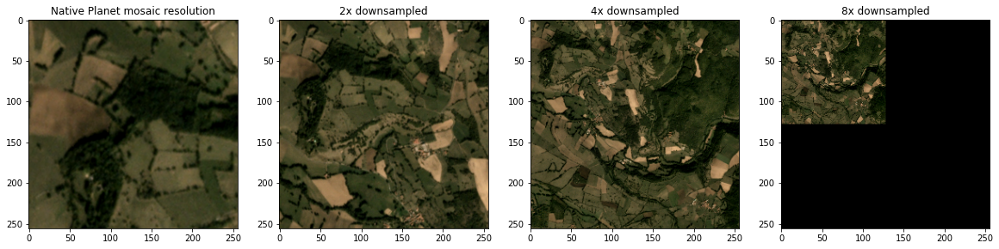

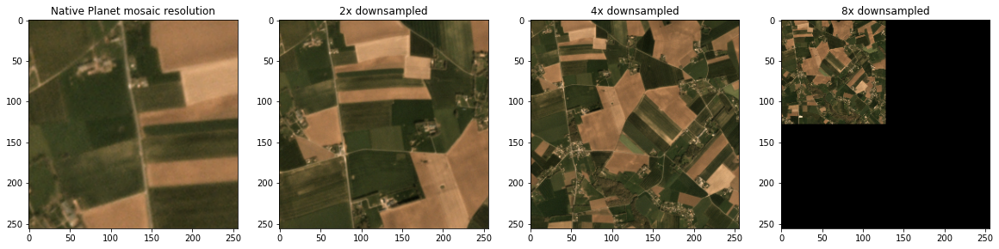

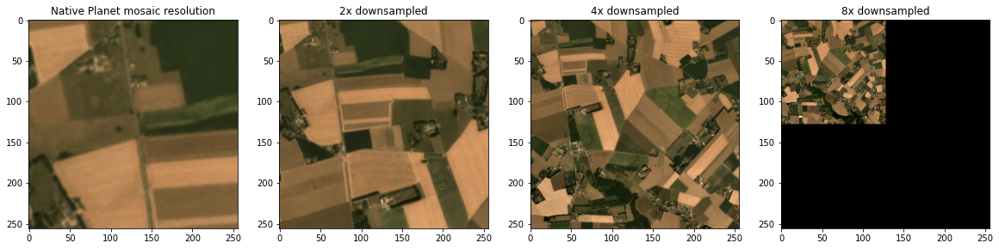

...

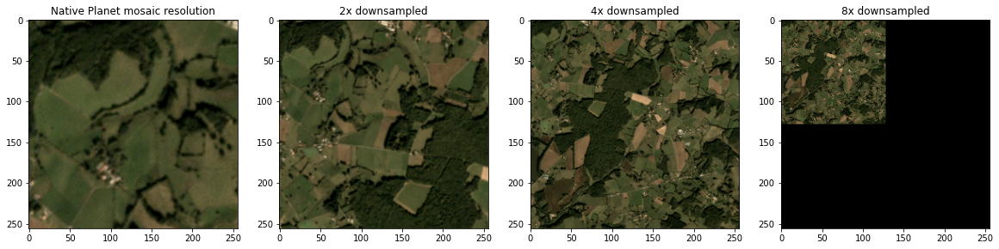

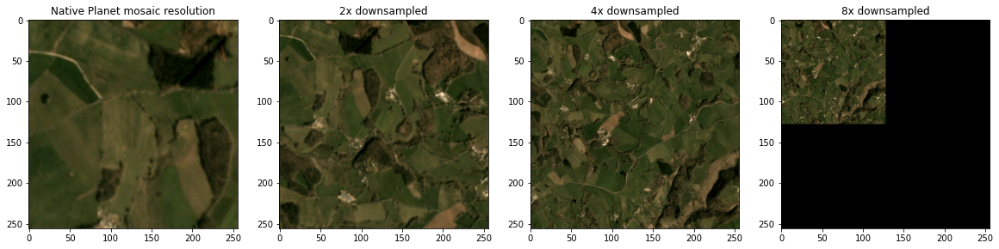

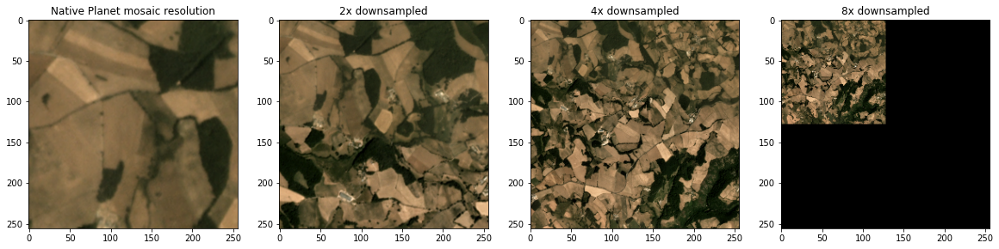

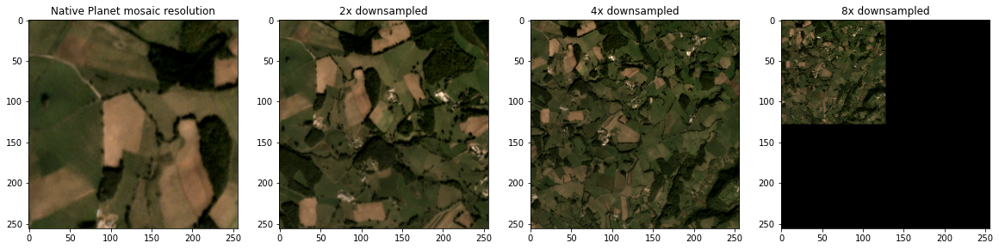

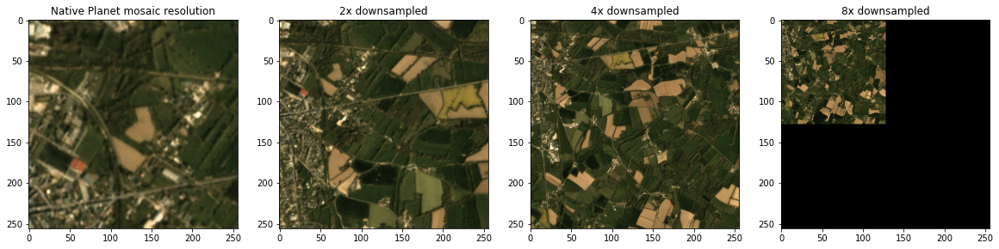

In [10]:
downsize_factors = [2, 4, 8]

# base_dir = '../data/planet/france/sherrie10k/monthly_mosaics_renamed_clipped_merged/'
base_dir = '../data/planet/france/'
source_dir = os.path.join(base_dir, '1250px') #, 'original', '2019_04')

img_names = sorted(os.listdir(source_dir))
for img_name in img_names:
    img = cv2.imread(os.path.join(source_dir, img_name))
    
    fig, ax = plt.subplots(1, 4, figsize=(20, 5))
    ax[0].imshow(cv2.cvtColor(img[:256, :256], cv2.COLOR_BGR2RGB))
    ax[0].set_title('Native Planet mosaic resolution')
    
    for i, downsize_factor in enumerate(downsize_factors):
        img2 = img[:downsize_factor*256, :downsize_factor*256]
        if downsize_factor < 8:
            downsized = cv2.resize(img2, (256, 256))
        elif downsize_factor == 8:
            downsized = np.zeros((256, 256, 3), dtype=np.uint8)
            downsized[:128, :128] = cv2.resize(img2, (128, 128))
        ax[i+1].imshow(cv2.cvtColor(downsized, cv2.COLOR_BGR2RGB))
        ax[i+1].set_title('{}x downsampled'.format(downsize_factor))
        
    plt.show()
    
    if img_name > '00005':
        break

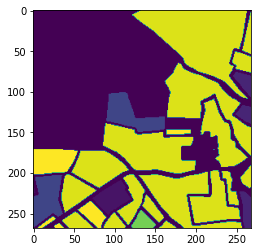

In [7]:
plt.imshow(imageio.imread('../data/planet/france/sherrie10k/extent_labels/00000.png'))
plt.show()

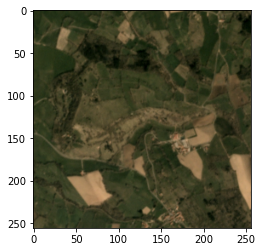

In [3]:
plt.imshow(cv2.cvtColor(downsized, cv2.COLOR_BGR2RGB))
plt.show()

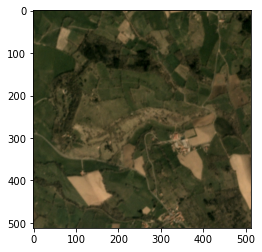

In [4]:
plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
plt.show()

# Save downsampled images

In [23]:
os.path.join(source_dir, img_name)

'../data/planet/france/sherrie10k/monthly_mosaics_renamed_clipped_merged/1250px/original/2019_07/08567_2019_07.tif'

In [15]:
# base_dir = '../data/planet/france/sherrie10k/monthly_mosaics_renamed_clipped_merged/'
base_dir = '../data/planet/france/'
# downsize_factors = [2, 4]
downsize_factors = [2, 3]
# months = ['2019_04', '2019_07', '2019_10']

source_dir = os.path.join(base_dir, '1250px', 'original')
img_names = sorted(os.listdir(source_dir))

for downsize_factor in downsize_factors:
#     for month in months:
#     source_dir = os.path.join(base_dir, '1250px', 'original', month)
    target_dir = os.path.join(base_dir, '1250px', '{}x_downsample'.format(downsize_factor)) #, month)
    if not os.path.exists(target_dir):
        os.makedirs(target_dir)
    
    for img_name in img_names:
        img = cv2.imread(os.path.join(source_dir, img_name))
        img2 = img[:downsize_factor*256, :downsize_factor*256]
        downsized = cv2.resize(img2, (256, 256))
        filename = os.path.join(target_dir, img_name)
        cv2.imwrite(filename, downsized)

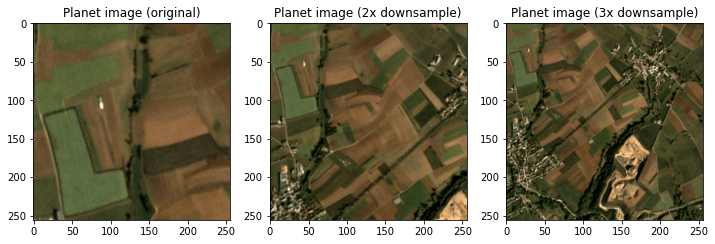

In [6]:
fig, ax = plt.subplots(1,3, figsize=(12,4))

image_id = '08500'
year_month = '_2019_10'

img = imageio.imread('../data/planet/france/sherrie10k/monthly_mosaics_renamed_clipped_merged/1250px/original/2019_10/{}.tif'.format(
    image_id + year_month))
ax[0].imshow(img[:256,:256])
ax[0].set_title('Planet image (original)')

img = imageio.imread('../data/planet/france/sherrie10k/monthly_mosaics_renamed_clipped_merged/1250px/2x_downsample/2019_10/{}.tif'.format(
    image_id + year_month))
ax[1].imshow(img)
ax[1].set_title('Planet image (2x downsample)')

img = imageio.imread('../data/planet/france/sherrie10k/monthly_mosaics_renamed_clipped_merged/1250px/3x_downsample/2019_10/{}.tif'.format(
    image_id + year_month))
ax[2].imshow(img)
ax[2].set_title('Planet image (3x downsample)')

plt.show()

# Save downsampled labels

## 2500px

In [21]:
base_dir = '../data/planet/france/sherrie10k/extent_labels/'
downsize_factors = [6] # 8

for downsize_factor in downsize_factors:
        
    source_dir = os.path.join(base_dir, '2500px', 'original_thickness12') # original_thickness16
    target_dir = os.path.join(base_dir, '2500px', '{}x_downsample'.format(downsize_factor))
    if not os.path.exists(target_dir):
        os.makedirs(target_dir)

    img_names = sorted(os.listdir(source_dir))
    already_saved = sorted(os.listdir(target_dir))
    for img_name in img_names:
        if img_name not in already_saved:
            img = cv2.imread(os.path.join(source_dir, img_name), cv2.IMREAD_UNCHANGED)
            img2 = img[:downsize_factor*256, :downsize_factor*256]
            downsized = cv2.resize(img2, (256, 256), interpolation=cv2.INTER_NEAREST)
            filename = os.path.join(target_dir, img_name)
            cv2.imwrite(filename, downsized)

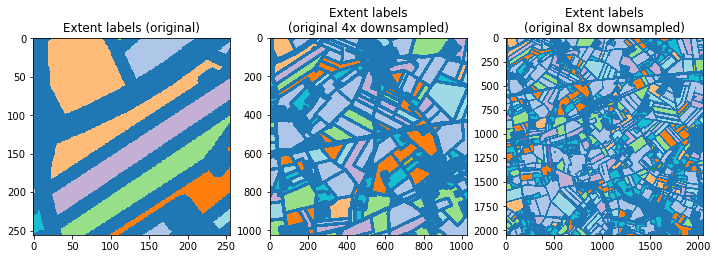

In [7]:
fig, ax = plt.subplots(1,3, figsize=(12,4))

image_id = '00001'
year_month = '_2019_10'

extent = imageio.imread('../data/planet/france/sherrie10k/extent_labels/2500px/original_thickness16/{}.png'.format(image_id))
ax[0].imshow(extent[:256,:256], cmap='tab20', vmin=0, vmax=19, interpolation='nearest')
ax[0].set_title('Extent labels (original)')

ax[1].imshow(extent[:256*4,:256*4], cmap='tab20', vmin=0, vmax=19, interpolation='nearest')
ax[1].set_title('Extent labels\n(original 4x downsampled)')

ax[2].imshow(extent[:256*8,:256*8], cmap='tab20', vmin=0, vmax=19, interpolation='nearest')
ax[2].set_title('Extent labels\n(original 8x downsampled)')

plt.show()

## 1250px

In [17]:
# base_dir = '../data/planet/france/sherrie10k/extent_labels/'
base_dir = '../data/planet/france/extent_labels/'
downsize_factors = [2]

for downsize_factor in downsize_factors:
    
    source_dir = os.path.join(base_dir, '1250px', 'original_thickness{}'.format(downsize_factor*2))
    target_dir = os.path.join(base_dir, '1250px', '{}x_downsample'.format(downsize_factor))
    if not os.path.exists(target_dir):
        os.makedirs(target_dir)

    img_names = sorted(os.listdir(source_dir))
    for img_name in img_names:
        img = cv2.imread(os.path.join(source_dir, img_name), cv2.IMREAD_UNCHANGED)
        img2 = img[:downsize_factor*256, :downsize_factor*256]
        downsized = cv2.resize(img2, (256, 256), interpolation=cv2.INTER_NEAREST)
        filename = os.path.join(target_dir, img_name)
        cv2.imwrite(filename, downsized)

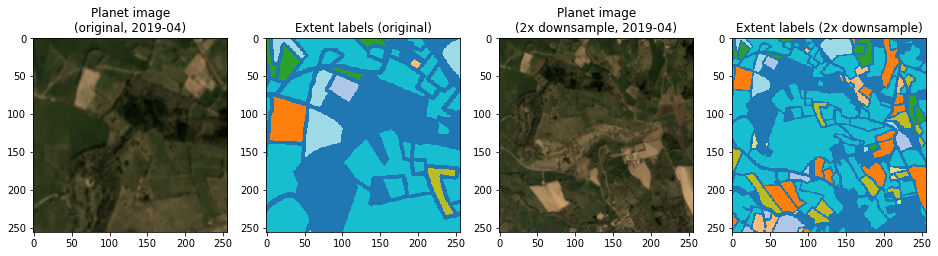

In [19]:
fig, ax = plt.subplots(1, 4, figsize=(16, 4))

image_id = '00000'
year_month = '_2019_04'

img = imageio.imread('../data/planet/france/sherrie10k/monthly_mosaics_renamed_clipped_merged/1250px/' +
                     'original/{}/{}.tif'.format(year_month[1:], image_id + year_month))
ax[0].imshow(img[:256, :256])
ax[0].set_title('Planet image\n(original, 2019-04)')

extent = imageio.imread('../data/planet/france/sherrie10k/extent_labels/1250px/original_thickness4/{}.png'.format(image_id))
ax[1].imshow(extent[:256,:256], cmap='tab20', vmin=0, vmax=19, interpolation='nearest')
ax[1].set_title('Extent labels (original)')

img = imageio.imread('../data/planet/france/sherrie10k/monthly_mosaics_renamed_clipped_merged/1250px/' +
                     '2x_downsample/{}/{}.tif'.format(year_month[1:], image_id + year_month))
ax[2].imshow(img[:256, :256])
ax[2].set_title('Planet image\n(2x downsample, 2019-04)')

extent2 = imageio.imread('../data/planet/france/sherrie10k/extent_labels/1250px/2x_downsample/{}.png'.format(image_id))
ax[3].imshow(extent2, cmap='tab20', vmin=0, vmax=19, interpolation='nearest')
ax[3].set_title('Extent labels (2x downsample)')

plt.show()

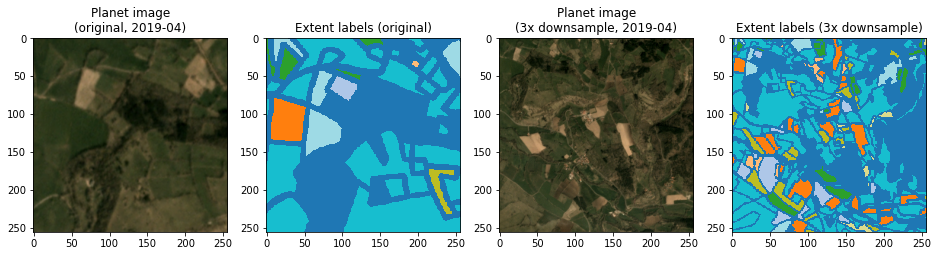

In [11]:
fig, ax = plt.subplots(1, 4, figsize=(16, 4))

image_id = '00000'
year_month = '_2019_04'

img = imageio.imread('../data/planet/france/sherrie10k/monthly_mosaics_renamed_clipped_merged/1250px/' +
                     'original/{}/{}.tif'.format(year_month[1:], image_id + year_month))
ax[0].imshow(img[:256, :256])
ax[0].set_title('Planet image\n(original, 2019-04)')

extent = imageio.imread('../data/planet/france/sherrie10k/extent_labels/1250px/original_thickness6/{}.png'.format(image_id))
ax[1].imshow(extent[:256,:256], cmap='tab20', vmin=0, vmax=19, interpolation='nearest')
ax[1].set_title('Extent labels (original)')

img = imageio.imread('../data/planet/france/sherrie10k/monthly_mosaics_renamed_clipped_merged/1250px/' +
                     '3x_downsample/{}/{}.tif'.format(year_month[1:], image_id + year_month))
ax[2].imshow(img[:256, :256])
ax[2].set_title('Planet image\n(3x downsample, 2019-04)')

extent2 = imageio.imread('../data/planet/france/sherrie10k/extent_labels/1250px/3x_downsample/{}.png'.format(image_id))
ax[3].imshow(extent2, cmap='tab20', vmin=0, vmax=19, interpolation='nearest')
ax[3].set_title('Extent labels (3x downsample)')

plt.show()

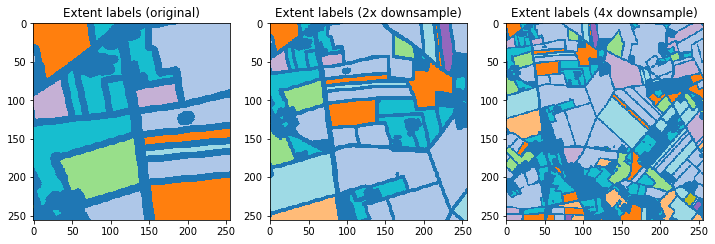

In [44]:
fig, ax = plt.subplots(1,3, figsize=(12,4))

image_id = '00001'
year_month = '_2019_10'

extent = imageio.imread('../data/planet/france/sherrie10k/extent_labels/1250px/original_thickness8/{}.png'.format(image_id))
ax[0].imshow(extent[:256,:256], cmap='tab20', vmin=0, vmax=19, interpolation='nearest')
ax[0].set_title('Extent labels (original)')

extent2 = imageio.imread('../data/planet/france/sherrie10k/extent_labels/1250px/2x_downsample/{}.png'.format(image_id))
ax[1].imshow(extent2, cmap='tab20', vmin=0, vmax=19, interpolation='nearest')
ax[1].set_title('Extent labels (2x downsample)')

extent2 = imageio.imread('../data/planet/france/sherrie10k/extent_labels/1250px/4x_downsample/{}.png'.format(image_id))
ax[2].imshow(extent2, cmap='tab20', vmin=0, vmax=19, interpolation='nearest')
ax[2].set_title('Extent labels (4x downsample)')

plt.show()

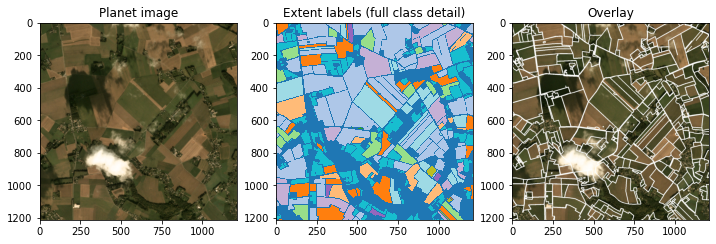

In [41]:
# thickness 8
fig, ax = plt.subplots(1,3, figsize=(12,4))

image_id = '00001'

mask = imageio.imread('../data/planet/france/sherrie10k/monthly_mosaics_renamed_clipped_merged/1250px/original/2019_10/{}.tif'.format(
    image_id + year_month))
ax[0].imshow(mask)
ax[0].set_title('Planet image')

extent = imageio.imread('../data/planet/france/sherrie10k/extent_labels/1250px/{}.png'.format(image_id))
ax[1].imshow(extent, cmap='tab20', interpolation='nearest', vmin=0, vmax=19)
ax[1].set_title('Extent labels (full class detail)')

overlay = imageio.imread('../data/planet/france/sherrie10k/overlays/1250px/{}.jpeg'.format(image_id))
ax[2].imshow(overlay)
ax[2].set_title('Overlay')

plt.show()

## 1250px for IoU

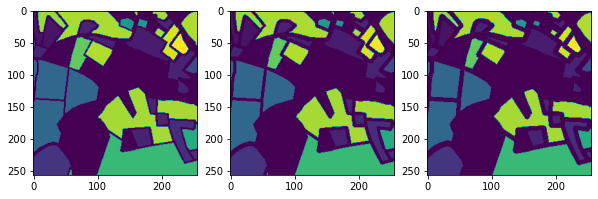

In [12]:
label1 = np.load('../data/planet/france/extent_labels/1250px/original_thickness2_for_IoU/00000.npy')
label2 = np.load('../data/planet/france/extent_labels/1250px/original_thickness4_for_IoU/00000.npy')
label3 = np.load('../data/planet/france/extent_labels/1250px/original_thickness6_for_IoU/00000.npy')
fig, ax = plt.subplots(1, 3, figsize=(10,5))
ax[0].imshow(label1[:256,:256])
ax[1].imshow(label2[:256,:256])
ax[2].imshow(label3[:256,:256])
plt.show()

In [17]:
# base_dir = '../data/planet/france/sherrie10k/extent_labels/'
base_dir = '../data/planet/france/extent_labels/'
downsize_factors = [2, 3]

for downsize_factor in downsize_factors:
    
    source_dir = os.path.join(base_dir, '1250px', 'original_thickness{}_for_IoU'.format(downsize_factor*2))
    target_dir = os.path.join(base_dir, '1250px', '{}x_downsample_for_IoU'.format(downsize_factor))
    if not os.path.exists(target_dir):
        os.makedirs(target_dir)

    img_names = sorted(os.listdir(source_dir))
    for img_name in img_names:
        img = np.load(os.path.join(source_dir, img_name))
        img2 = img[:downsize_factor*256, :downsize_factor*256]
        downsized = cv2.resize(img2, (256, 256), interpolation=cv2.INTER_NEAREST)
        filename = os.path.join(target_dir, img_name)
        np.save(filename, downsized)

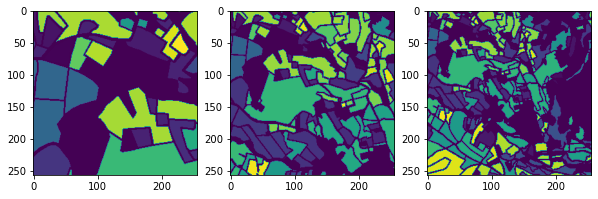

In [18]:
label1 = np.load('../data/planet/france/extent_labels/1250px/original_thickness2_for_IoU/00000.npy')
label2 = np.load('../data/planet/france/extent_labels/1250px/2x_downsample_for_IoU/00000.npy')
label3 = np.load('../data/planet/france/extent_labels/1250px/3x_downsample_for_IoU/00000.npy')
fig, ax = plt.subplots(1, 3, figsize=(10,5))
ax[0].imshow(label1[:256,:256])
ax[1].imshow(label2[:256,:256])
ax[2].imshow(label3[:256,:256])
plt.show()

## 1250px partial

In [7]:
base_dir = '../data/planet/france/sherrie10k/extent_labels/'
downsize_factors = [3]

for downsize_factor in downsize_factors:
        
    source_dir = os.path.join(base_dir, '1250px_2field', 'original_thickness6')
    target_dir = os.path.join(base_dir, '1250px_2field', '{}x_downsample'.format(downsize_factor))
    if not os.path.exists(target_dir):
        os.makedirs(target_dir)

    img_names = sorted(os.listdir(source_dir))
    for img_name in img_names:
        img = cv2.imread(os.path.join(source_dir, img_name), cv2.IMREAD_UNCHANGED)
        img2 = img[:downsize_factor*256, :downsize_factor*256]
        downsized = cv2.resize(img2, (256, 256), interpolation=cv2.INTER_NEAREST)
        filename = os.path.join(target_dir, img_name)
        cv2.imwrite(filename, downsized)

# Make new splits files for 2x and 4x downsampled

In [2]:
old_splits = pd.read_csv('../data/splits/sherrie10k_planetImagery_splits_20x20.csv')
old_splits['image_id'] = old_splits['image_id'].astype(str).str.zfill(5)

In [3]:
saved_extents = os.listdir('../data/planet/france/sherrie10k/extent_labels/1250px/2x_downsample/')
saved_image_ids_2x = [x.split('.')[0] for x in saved_extents]
saved_extents = os.listdir('../data/planet/france/sherrie10k/extent_labels/1250px/4x_downsample/')
saved_image_ids_4x = [x.split('.')[0] for x in saved_extents]
saved_extents = os.listdir('../data/planet/france/sherrie10k/extent_labels/2500px/6x_downsample/')
saved_image_ids_6x = [x.split('.')[0] for x in saved_extents]
saved_extents = os.listdir('../data/planet/france/sherrie10k/extent_labels/2500px/8x_downsample/')
saved_image_ids_8x = [x.split('.')[0] for x in saved_extents]

In [7]:
downsampled_splits = old_splits[old_splits['image_id'].isin(saved_image_ids_2x) &
                                old_splits['image_id'].isin(saved_image_ids_4x) &
                                old_splits['image_id'].isin(saved_image_ids_6x) &
                                old_splits['image_id'].isin(saved_image_ids_8x)].reset_index(drop=True)
downsampled_splits.to_csv('../data/splits/sherrie10k_planetImagery_splits_20x20_1x-8x-downsampled.csv', index=False)

## Try 8x downsampled

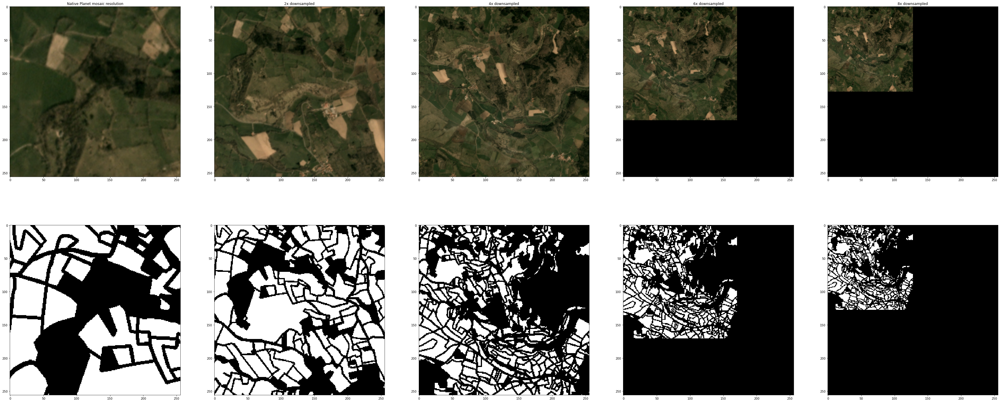

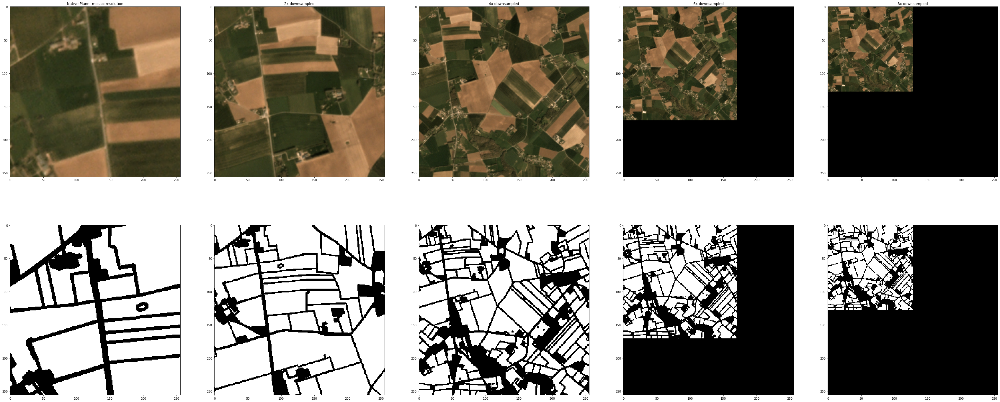

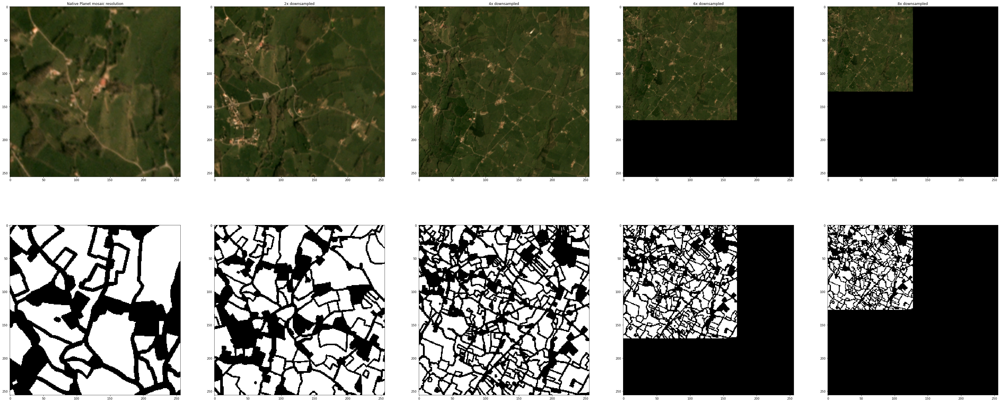

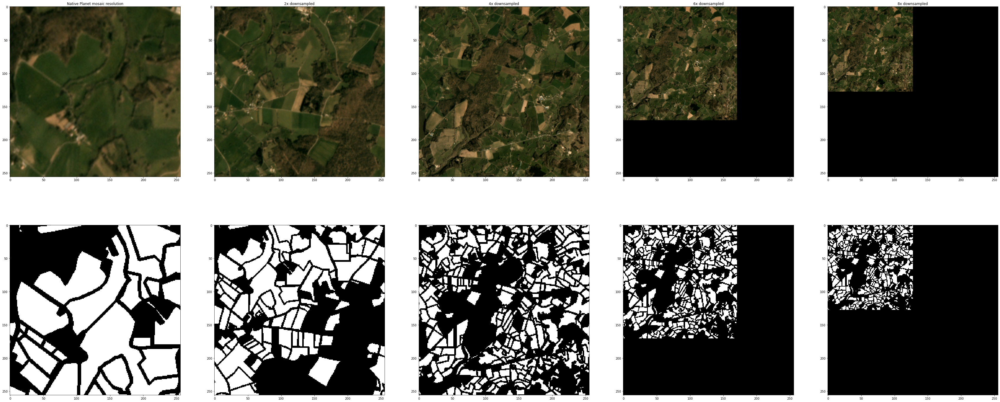

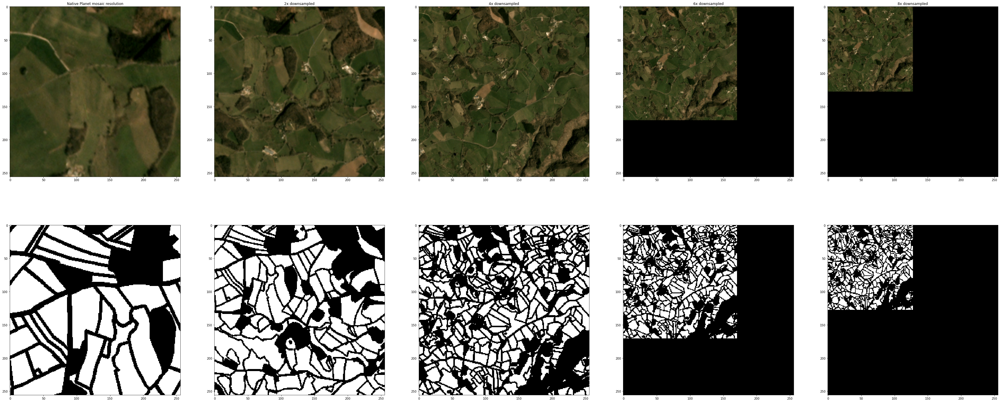

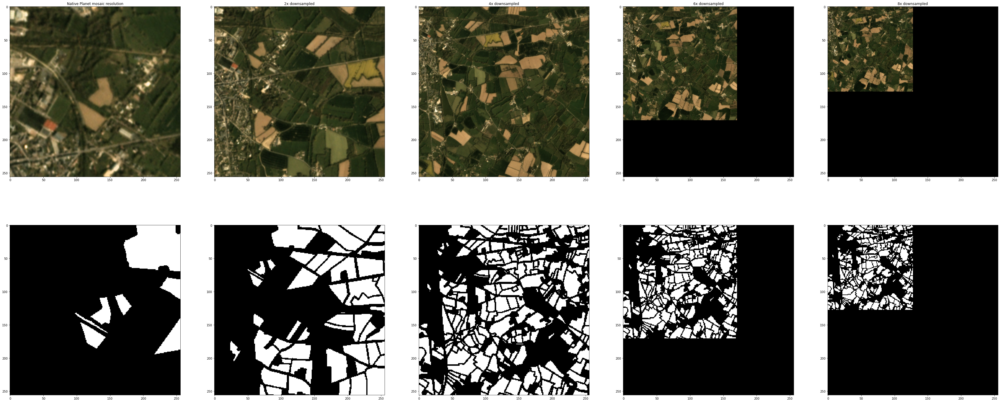

In [31]:
downsize_factors = [2, 4, 6, 8]

base_dir = '../data/planet/france/sherrie10k/monthly_mosaics_renamed_clipped_merged/'
source_dir = os.path.join(base_dir, '1250px', 'original', '2019_04')

img_names = sorted(os.listdir(source_dir))
for img_name in img_names:
    img_id = img_name.split('_')[0]
    img = cv2.imread(os.path.join(source_dir, img_name))
    
    fig, ax = plt.subplots(2, 5, figsize=(60, 25))
    ax[0,0].imshow(cv2.cvtColor(img[:256, :256], cv2.COLOR_BGR2RGB))
    ax[0,0].set_title('Native Planet mosaic resolution')
    
    label = imageio.imread(
        '../data/planet/france/sherrie10k/extent_labels/1250px/original_thickness4/{}.png'.format(img_id))
    ax[1,0].imshow(label[:256,:256] > 0, interpolation='nearest', cmap='Greys_r')
    
    for i, downsize_factor in enumerate(downsize_factors):
        img2 = img[:downsize_factor*256, :downsize_factor*256]
        if downsize_factor <= 4:
            downsized = cv2.resize(img2, (256, 256))
        elif downsize_factor == 6:
            downsized = np.zeros((256, 256, 3), dtype=np.uint8)
            downsized[:171, :171] = cv2.resize(img2, (171, 171))
        elif downsize_factor == 8:
            downsized = np.zeros((256, 256, 3), dtype=np.uint8)
            downsized[:128, :128] = cv2.resize(img2, (128, 128))
        ax[0,i+1].imshow(cv2.cvtColor(downsized, cv2.COLOR_BGR2RGB))
        ax[0,i+1].set_title('{}x downsampled'.format(downsize_factor))
        
        if downsize_factor <= 4:
            label = imageio.imread(
                '../data/planet/france/sherrie10k/extent_labels/1250px/{}x_downsample/{}.png'.format(downsize_factor, img_id))
        elif downsize_factor == 6:
            label = np.zeros((256, 256))
            temp = imageio.imread(
                '../data/planet/france/sherrie10k/extent_labels/1250px/original_thickness8/{}.png'.format(img_id))
            temp = temp[:4*256, :4*256]
            label[:171, :171] = cv2.resize(temp, (171, 171), interpolation=cv2.INTER_NEAREST)
        elif downsize_factor == 8:
            label = np.zeros((256, 256))
            temp = imageio.imread(
                '../data/planet/france/sherrie10k/extent_labels/1250px/original_thickness8/{}.png'.format(img_id))
            temp = temp[:4*256, :4*256]
            label[:128, :128] = cv2.resize(temp, (128, 128), interpolation=cv2.INTER_NEAREST)
        ax[1,i+1].imshow(label > 0, interpolation='nearest', cmap='Greys_r')
        
    plt.show()
    
    if img_name > '00005':
        break

In [ ]:
# resize and delete 2500px version
for month in ['2019_04', '2019_07', '2019_10']:
    if not os.path.exists(os.path.join(base_dir, '2500px', '6x_downsample', month)):
        os.makedirs(os.path.join(base_dir, '2500px', '6x_downsample', month))
    if not os.path.exists(os.path.join(base_dir, '2500px', '8x_downsample', month)):
        os.makedirs(os.path.join(base_dir, '2500px', '8x_downsample', month))

while True:
    
    img_names = [x for x in os.listdir(base_dir) if '.tif' in x]
    
    if len(img_names) >= 750:

        for img_name in sorted(img_names):
            img = cv2.imread(os.path.join(base_dir, img_name))
            month = img_name[6:13]

            # save 6x downsampled version
            img2 = img[:1536, :1536, :3]
            downsampled6x = cv2.resize(img2, (256, 256))
            filename = os.path.join(base_dir, '2500px', '6x_downsample', month, img_name)
            cv2.imwrite(filename, downsampled6x)

            # save 8x downsampled version
            img3 = img[:2048, :2048, :3]
            downsampled8x = cv2.resize(img3, (256, 256))
            filename = os.path.join(base_dir, '2500px', '8x_downsample', month, img_name)
            cv2.imwrite(filename, downsampled8x)

            # delete 2500px image
            os.remove(os.path.join(base_dir, img_name))
        
    time.sleep(600)

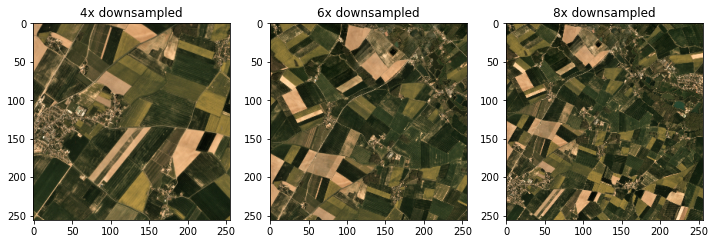

In [60]:
fig, ax = plt.subplots(1,3, figsize=(12, 4))

img = imageio.imread(os.path.join(base_dir, '1250px/4x_downsample/2019_04/03243_2019_04.tif'))
ax[0].imshow(img)
ax[0].set_title('4x downsampled')

img = imageio.imread(os.path.join(base_dir, '2500px/6x_downsample/2019_04/03243_2019_04.tif'))
ax[1].imshow(img)
ax[1].set_title('6x downsampled')

img = imageio.imread(os.path.join(base_dir, '2500px/8x_downsample/2019_04/03243_2019_04.tif'))
ax[2].imshow(img)
ax[2].set_title('8x downsampled')
plt.show()

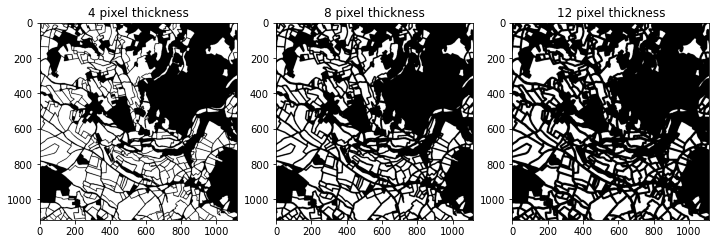

In [62]:
fig, ax = plt.subplots(1,3, figsize=(12, 4))

label_4 = imageio.imread('../data/planet/france/sherrie10k/extent_labels/1250px/original_thickness4/00000.png')
label_8 = imageio.imread('../data/planet/france/sherrie10k/extent_labels/1250px/original_thickness8/00000.png')
label_12 = imageio.imread('../data/planet/france/sherrie10k/extent_labels/1250px/original_thickness12/00000.png')

ax[0].imshow(label_4 > 0, cmap='Greys_r')
ax[0].set_title('4 pixel thickness')
ax[1].imshow(label_8 > 0, cmap='Greys_r')
ax[1].set_title('8 pixel thickness')
ax[2].imshow(label_12 > 0, cmap='Greys_r')
ax[2].set_title('12 pixel thickness')
plt.show()